# Colorado Monetization Contest

In this exercise, we will create a CycleGan model and train it to convert real photos to Monet-style painting images.

This is part of the "I'm Something of a Painter Myself" competition on Kaggle.  Submission created for my UC Boulder Intro to Deep Learning class.

## References

For this exercise, I was heavily reliant upon Amy Jang's contest tutorial linked here, https://www.kaggle.com/code/amyjang/monet-cyclegan-tutorial, as well as Dimitre Oliveira's tutorial here: https://www.kaggle.com/code/dimitreoliveira/introduction-to-cyclegan-monet-paintings

Also, the ArXiv CycleGan paper is available here: https://arxiv.org/pdf/1703.10593.pdf

We will set up to use the GPU below.

In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

import numpy as np
import matplotlib.pyplot as plt

from kaggle_datasets import KaggleDatasets
import os
import PIL
from tqdm import tqdm

# Check for TPU
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Running on TPU:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.TPUStrategy(tpu)
except:
    # Check for GPU
    if tf.config.list_physical_devices('GPU'):
        print('Running on GPU')
        strategy = tf.distribute.MirroredStrategy()
    else:
        # Default strategy for CPU
        print('Running on CPU')
        strategy = tf.distribute.get_strategy()

print('Number of accelerators:', strategy.num_replicas_in_sync)


Running on GPU
Number of accelerators: 2


## We will set some global variables for tweaking

33 EPOCHS takes just a bit under 5 hours of training time (the contest limit) with GPU using my model.

In [2]:
HEIGHT = 256
WIDTH = 256
CHANNELS = 3
EPOCHS = 32
BATCH_SIZE = 4

In [3]:
AUTOTUNE = tf.data.AUTOTUNE

# File paths for Monet and photo TFRecords (modified to access the file paths directly)
monet_files = tf.io.gfile.glob('/kaggle/input/gan-getting-started/monet_tfrec/*.tfrec')
photo_files = tf.io.gfile.glob('/kaggle/input/gan-getting-started/photo_tfrec/*.tfrec')

print('Monet TFRecord files:', len(monet_files))
print('Photo TFRecord files:', len(photo_files))

Monet TFRecord files: 5
Photo TFRecord files: 20


# Set up our Data Pipeline

The contest dataset uses the tfrecord format to store images, both Monet painting images and the photo test subjects.

We will set up some helper functions to process the data in this format.

In [4]:
IMAGE_SIZE = [256, 256]

def decode_image(image):
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, IMAGE_SIZE)
    image = (tf.cast(image, tf.float32) / 127.5) - 1  # Normalize to [-1, 1]
    return image

def read_tfrecord(example):
    tfrecord_format = {
        'image_name': tf.io.FixedLenFeature([], tf.string),
        'image': tf.io.FixedLenFeature([], tf.string),
        'target': tf.io.FixedLenFeature([], tf.string),  # Change from tf.int64 to tf.string
    }
    example = tf.io.parse_single_example(example, tfrecord_format)
    image = decode_image(example['image'])
    return image

def load_dataset(filenames):
    # Read TFRecords and parse into images
    dataset = tf.data.TFRecordDataset(filenames, num_parallel_reads=AUTOTUNE)
    dataset = dataset.map(read_tfrecord, num_parallel_calls=AUTOTUNE)
    return dataset

monet_dataset = load_dataset(monet_files).repeat().batch(BATCH_SIZE, drop_remainder=True)
photo_dataset = load_dataset(photo_files).repeat().batch(BATCH_SIZE, drop_remainder=True)

## Let's display some sample images

Monet Paintings


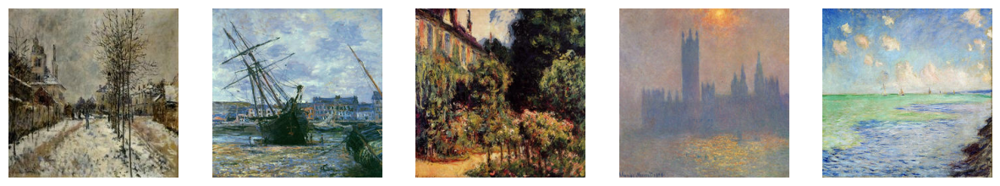

Photos


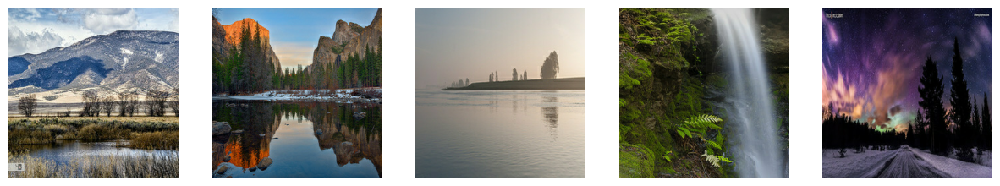

In [5]:
# Function to display sample images
def display_samples(dataset, n_samples):
    plt.figure(figsize=(15, 5))
    for i, image in enumerate(dataset.take(n_samples)):
        plt.subplot(1, n_samples, i+1)
        plt.imshow((image[0] * 0.5) + 0.5)
        plt.axis('off')
    plt.show()

def display_generated_samples(dataset, generator, num_samples):
    for i, real_image in enumerate(dataset.take(num_samples)):
        # Ensure the image has a batch dimension
        if len(real_image.shape) == 3:
            real_image = tf.expand_dims(real_image, 0)
        
        # Generate the translated image using the provided generator
        generated_image = generator(real_image, training=False)
        
        # Remove batch dimension for visualization
        real_image = tf.squeeze(real_image, axis=0)
        generated_image = tf.squeeze(generated_image, axis=0)
        
        # Convert pixel values from [-1, 1] to [0, 1] for display
        real_image = (real_image * 0.5) + 0.5
        generated_image = (generated_image * 0.5) + 0.5
        
        # Plot the real and generated images
        plt.figure(figsize=(12, 6))
        
        plt.subplot(1, 2, 1)
        plt.title("Input Image")
        plt.imshow(real_image)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.title("Generated Image")
        plt.imshow(generated_image)
        plt.axis('off')
        
        plt.show()

print('Monet Paintings')
display_samples(monet_dataset, 5)

print('Photos')
display_samples(photo_dataset, 5)

# Building the Model

In [6]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = keras.Sequential()
    result.add(layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                     kernel_initializer=initializer, use_bias=False))
    result.add(layers.GroupNormalization(groups=-1))  # Using GroupNormalization instead of InstanceNormalization - better performance
    if apply_dropout:
        result.add(layers.Dropout(0.5))
    result.add(layers.ReLU())
    return result

def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = keras.Sequential()
    result.add(layers.Conv2D(filters, size, strides=2, padding='same',
                            kernel_initializer=initializer, use_bias=False))
    if apply_norm:
        result.add(layers.GroupNormalization(groups=-1)) # Using GroupNormalization instead of InstanceNormalization - better performance
    result.add(layers.LeakyReLU())
    return result



## The Generator Model

In [7]:
def build_generator():
    inputs = layers.Input(shape=[256, 256, 3])

    # Encoder: Downsampling layers
    
    down_layers = [
        downsample(64, 4, apply_norm=False),  # (bs, 128, 128, 64)
        downsample(128, 4),                   # (bs, 64, 64, 128)
        downsample(256, 4),                   # (bs, 32, 32, 256)
        downsample(512, 4),                   # (bs, 16, 16, 512)
        downsample(512, 4),                   # (bs, 8, 8, 512)
        downsample(512, 4),                   # (bs, 4, 4, 512)
        downsample(512, 4),                   # (bs, 2, 2, 512)
        downsample(512, 4),                   # (bs, 1, 1, 512)
    ]

    # Decoder: Upsampling layers
    up_layers = [
        upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
        upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
        upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
        upsample(512, 4),                     # (bs, 16, 16, 1024)
        upsample(256, 4),                     # (bs, 32, 32, 512)
        upsample(128, 4),                     # (bs, 64, 64, 256)
        upsample(64, 4),                      # (bs, 128, 128, 128)
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    outputs = layers.Conv2DTranspose(3, 4, strides=2, padding='same',
                                     kernel_initializer=initializer,
                                     activation='tanh')  # (bs, 256, 256, 3)

    # Connect the layers
    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_layers:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_layers, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])
    x = outputs(x)
    return keras.Model(inputs=inputs, outputs=x)


## The Discriminator Model

In [8]:
def build_discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    inp = layers.Input(shape=[256, 256, 3], name='input_image')

    x = inp
    down1 = downsample(64, 4, apply_norm=False)(x)  # (bs, 128, 128, 64)
    down2 = downsample(128, 4)(down1)                   # (bs, 64, 64, 128)
    down3 = downsample(256, 4)(down2)                   # (bs, 32, 32, 256)
    down4 = downsample(512, 4)(down3)                   # (bs, 16, 16, 512)
    zero_pad1 = layers.ZeroPadding2D()(down4)               # (bs, 18, 18, 512)
    conv = layers.Conv2D(512, 4, strides=1,
                      kernel_initializer=initializer,
                      use_bias=False)(zero_pad1)        # (bs, 15, 15, 512)
    norm1 = layers.GroupNormalization(groups=-1)(conv)
    leaky_relu = layers.LeakyReLU()(conv)
    zero_pad2 = layers.ZeroPadding2D()(leaky_relu)               # (bs, 17, 17, 512)
    conv2 = layers.Conv2D(1, 4, strides=1,
                      kernel_initializer=initializer)(zero_pad2)  # (bs, 14, 14, 1)
    return keras.Model(inputs=inp, outputs=conv2)


## Build Model (CycleGan)

In [9]:
with strategy.scope():
    monet_generator = build_generator()      # Generator G: Photo to Monet
    photo_generator = build_generator()      # Generator F: Monet to Photo
    monet_discriminator = build_discriminator()  # Discriminator Y
    photo_discriminator = build_discriminator()  # Discriminator X

In [10]:
class CycleGAN(keras.Model):
    def __init__(self, generator_G, generator_F, discriminator_X, discriminator_Y, lambda_cycle=10.0):
        super(CycleGAN, self).__init__()
        self.generator_G = generator_G  # Photo to Monet
        self.generator_F = generator_F  # Monet to Photo
        self.discriminator_X = discriminator_X  # Discriminator for Photos
        self.discriminator_Y = discriminator_Y  # Discriminator for Monet paintings
        self.lambda_cycle = lambda_cycle

    def compile(self, gen_G_optimizer, gen_F_optimizer,
                disc_X_optimizer, disc_Y_optimizer,
                gen_loss_fn, disc_loss_fn,
                cycle_loss_fn, identity_loss_fn):
        super(CycleGAN, self).compile()
        self.gen_G_optimizer = gen_G_optimizer
        self.gen_F_optimizer = gen_F_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn

    def train_step(self, batch_data):
        real_x, real_y = batch_data  # real_x: photos, real_y: Monet paintings

        with tf.GradientTape(persistent=True) as tape:
            # Generate fake images
            fake_y = self.generator_G(real_x, training=True)  # Photo to Monet
            cycled_x = self.generator_F(fake_y, training=True)  # Monet back to Photo

            fake_x = self.generator_F(real_y, training=True)  # Monet to Photo
            cycled_y = self.generator_G(fake_x, training=True)  # Photo back to Monet

            # Identity mapping
            same_x = self.generator_F(real_x, training=True)
            same_y = self.generator_G(real_y, training=True)

            # Discriminator output
            disc_real_x = self.discriminator_X(real_x, training=True)
            disc_real_y = self.discriminator_Y(real_y, training=True)

            disc_fake_x = self.discriminator_X(fake_x, training=True)
            disc_fake_y = self.discriminator_Y(fake_y, training=True)

            # Calculate losses
            gen_G_loss = self.gen_loss_fn(disc_fake_y)
            gen_F_loss = self.gen_loss_fn(disc_fake_x)

            total_cycle_loss = self.cycle_loss_fn(real_x, cycled_x, self.lambda_cycle) + \
                               self.cycle_loss_fn(real_y, cycled_y, self.lambda_cycle)

            id_loss_X = self.identity_loss_fn(real_x, same_x, self.lambda_cycle)
            id_loss_Y = self.identity_loss_fn(real_y, same_y, self.lambda_cycle)

            total_gen_G_loss = gen_G_loss + total_cycle_loss + id_loss_Y
            total_gen_F_loss = gen_F_loss + total_cycle_loss + id_loss_X

            disc_X_loss = self.disc_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.disc_loss_fn(disc_real_y, disc_fake_y)

        # Calculate gradients
        grads_gen_G = tape.gradient(total_gen_G_loss, self.generator_G.trainable_variables)
        grads_gen_F = tape.gradient(total_gen_F_loss, self.generator_F.trainable_variables)

        grads_disc_X = tape.gradient(disc_X_loss, self.discriminator_X.trainable_variables)
        grads_disc_Y = tape.gradient(disc_Y_loss, self.discriminator_Y.trainable_variables)

        # Apply gradients
        self.gen_G_optimizer.apply_gradients(zip(grads_gen_G, self.generator_G.trainable_variables))
        self.gen_F_optimizer.apply_gradients(zip(grads_gen_F, self.generator_F.trainable_variables))

        self.disc_X_optimizer.apply_gradients(zip(grads_disc_X, self.discriminator_X.trainable_variables))
        self.disc_Y_optimizer.apply_gradients(zip(grads_disc_Y, self.discriminator_Y.trainable_variables))

        return {
            'G_loss': total_gen_G_loss,
            'F_loss': total_gen_F_loss,
            'D_X_loss': disc_X_loss,
            'D_Y_loss': disc_Y_loss,
        }

## Loss Functions

In [11]:
with strategy.scope():
    # Binary Cross Entropy loss function
    loss_obj = keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)

    def generator_loss(generated):
        return tf.reduce_mean(loss_obj(tf.ones_like(generated), generated))

    def discriminator_loss(real, generated):
        real_loss = loss_obj(tf.ones_like(real), real)
        generated_loss = loss_obj(tf.zeros_like(generated), generated)
        total_loss = real_loss + generated_loss
        return tf.reduce_mean(total_loss) * 0.5

    def calc_cycle_loss(real_image, cycled_image, lambda_cycle):
        loss = tf.reduce_mean(tf.abs(real_image - cycled_image))
        return lambda_cycle * loss

    def identity_loss(real_image, same_image, lambda_identity):
        loss = tf.reduce_mean(tf.abs(real_image - same_image))
        return lambda_identity * 0.5 * loss

In [12]:
with strategy.scope():
    gen_G_optimizer = keras.optimizers.Adam(2e-4, beta_1=0.5)
    gen_F_optimizer = keras.optimizers.Adam(2e-4, beta_1=0.5)
    disc_X_optimizer = keras.optimizers.Adam(2e-4, beta_1=0.5)
    disc_Y_optimizer = keras.optimizers.Adam(2e-4, beta_1=0.5)

with strategy.scope():
    cycle_gan_model = CycleGAN(generator_G=monet_generator, generator_F=photo_generator,
                               discriminator_X=photo_discriminator, discriminator_Y=monet_discriminator)

    cycle_gan_model.compile(
        gen_G_optimizer=gen_G_optimizer,
        gen_F_optimizer=gen_F_optimizer,
        disc_X_optimizer=disc_X_optimizer,
        disc_Y_optimizer=disc_Y_optimizer,
        gen_loss_fn=generator_loss,
        disc_loss_fn=discriminator_loss,
        cycle_loss_fn=calc_cycle_loss,
        identity_loss_fn=identity_loss
    )

# Train the Model

## Prepare Dataset to feed Model

In [13]:
train_dataset = tf.data.Dataset.zip((photo_dataset, monet_dataset))
train_dataset = train_dataset.shuffle(buffer_size=1024)
train_dataset = train_dataset.prefetch(tf.data.AUTOTUNE)


## Add Display Callback and Train

I added a Display Callback function so that we can see how the model progressively improves as it trains

Epoch 1/32


2024-12-07 21:28:48.828009: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inStatefulPartitionedCall/cond/else/_738/cond/StatefulPartitionedCall/gradient_tape/functional_16_5/sequential_10_1/dropout_2_1/stateless_dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 673ms/step - D_X_loss: 0.6920 - D_Y_loss: 0.7262 - F_loss: 5.3293 - G_loss: 5.1140

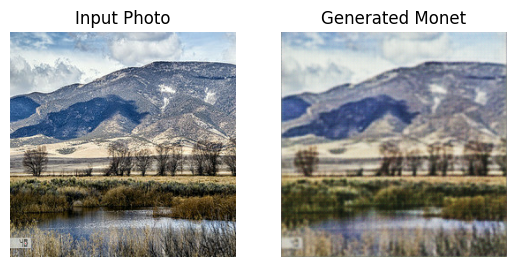

450/450 ━━━━━━━━━━━━━━━━━━━━ 418s 676ms/step - D_X_loss: 0.6916 - D_Y_loss: 0.7261 - F_loss: 5.3268 - G_loss: 5.1110
Epoch 2/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 682ms/step - D_X_loss: 0.5669 - D_Y_loss: 0.6391 - F_loss: 4.2141 - G_loss: 3.7853

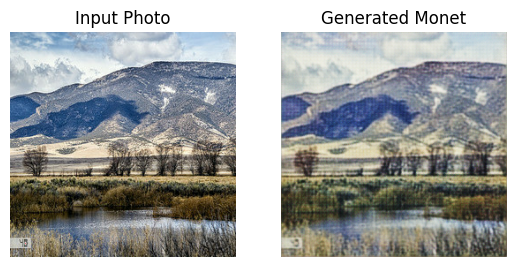

450/450 ━━━━━━━━━━━━━━━━━━━━ 307s 683ms/step - D_X_loss: 0.5672 - D_Y_loss: 0.6390 - F_loss: 4.2118 - G_loss: 3.7847
Epoch 3/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.5604 - D_Y_loss: 0.6242 - F_loss: 4.0117 - G_loss: 3.6063

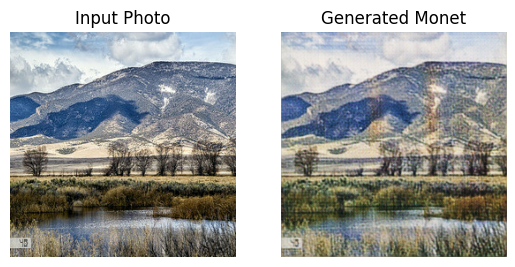

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 679ms/step - D_X_loss: 0.5605 - D_Y_loss: 0.6237 - F_loss: 4.0108 - G_loss: 3.6064
Epoch 4/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 680ms/step - D_X_loss: 0.5597 - D_Y_loss: 0.6295 - F_loss: 3.7912 - G_loss: 3.3773

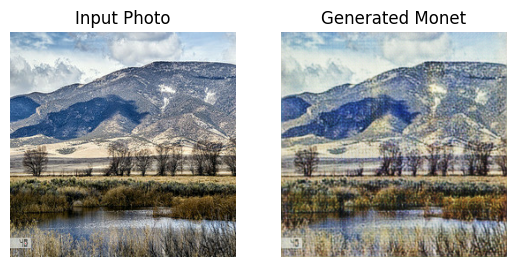

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 681ms/step - D_X_loss: 0.5596 - D_Y_loss: 0.6293 - F_loss: 3.7915 - G_loss: 3.3780
Epoch 5/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 681ms/step - D_X_loss: 0.5670 - D_Y_loss: 0.6192 - F_loss: 3.6413 - G_loss: 3.2988

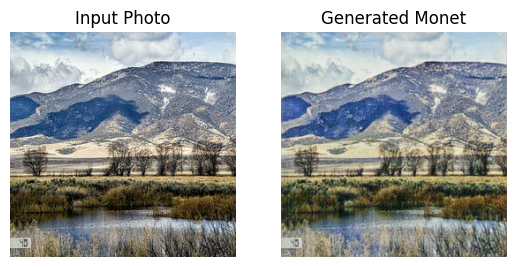

450/450 ━━━━━━━━━━━━━━━━━━━━ 307s 682ms/step - D_X_loss: 0.5675 - D_Y_loss: 0.6191 - F_loss: 3.6399 - G_loss: 3.2987
Epoch 6/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 679ms/step - D_X_loss: 0.5713 - D_Y_loss: 0.6126 - F_loss: 3.5556 - G_loss: 3.2748

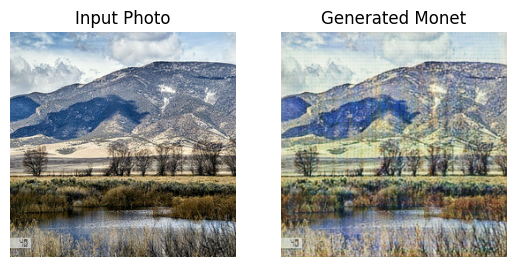

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 679ms/step - D_X_loss: 0.5709 - D_Y_loss: 0.6127 - F_loss: 3.5556 - G_loss: 3.2754
Epoch 7/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 676ms/step - D_X_loss: 0.5751 - D_Y_loss: 0.5964 - F_loss: 3.5287 - G_loss: 3.3451

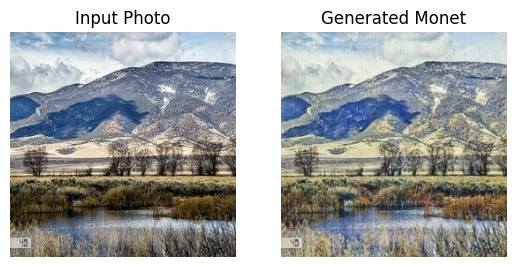

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 677ms/step - D_X_loss: 0.5754 - D_Y_loss: 0.5965 - F_loss: 3.5275 - G_loss: 3.3452
Epoch 8/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.5879 - D_Y_loss: 0.5750 - F_loss: 3.4549 - G_loss: 3.4359

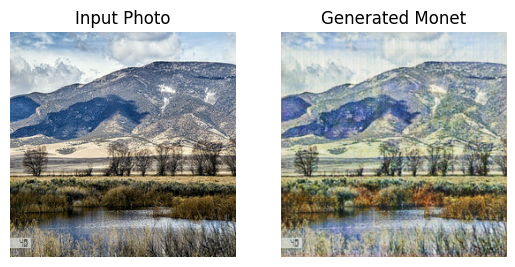

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 679ms/step - D_X_loss: 0.5880 - D_Y_loss: 0.5750 - F_loss: 3.4542 - G_loss: 3.4363
Epoch 9/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 681ms/step - D_X_loss: 0.5870 - D_Y_loss: 0.5447 - F_loss: 3.4842 - G_loss: 3.5716

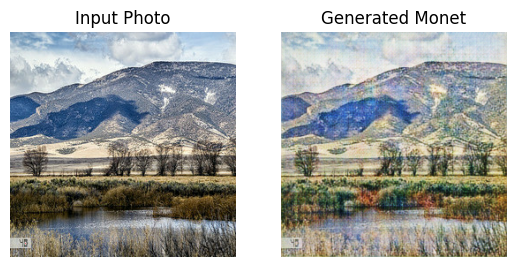

450/450 ━━━━━━━━━━━━━━━━━━━━ 307s 681ms/step - D_X_loss: 0.5871 - D_Y_loss: 0.5446 - F_loss: 3.4831 - G_loss: 3.5726
Epoch 10/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.5907 - D_Y_loss: 0.5101 - F_loss: 3.4647 - G_loss: 3.7013

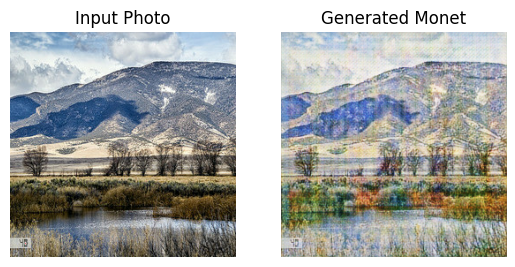

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 679ms/step - D_X_loss: 0.5910 - D_Y_loss: 0.5101 - F_loss: 3.4653 - G_loss: 3.7003
Epoch 11/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 677ms/step - D_X_loss: 0.5856 - D_Y_loss: 0.4746 - F_loss: 3.4921 - G_loss: 3.9029

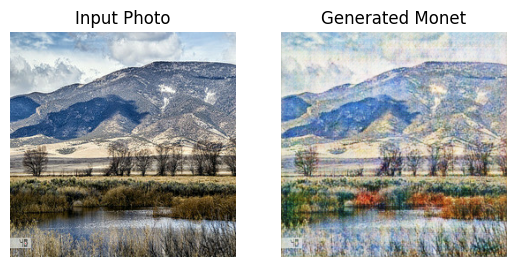

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 678ms/step - D_X_loss: 0.5854 - D_Y_loss: 0.4742 - F_loss: 3.4928 - G_loss: 3.9031
Epoch 12/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.5722 - D_Y_loss: 0.4085 - F_loss: 3.6431 - G_loss: 4.3640

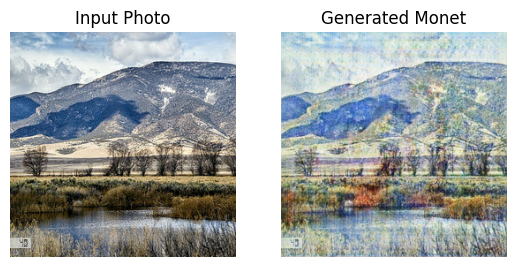

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 679ms/step - D_X_loss: 0.5722 - D_Y_loss: 0.4086 - F_loss: 3.6431 - G_loss: 4.3635
Epoch 13/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.5753 - D_Y_loss: 0.3807 - F_loss: 3.6106 - G_loss: 4.5387

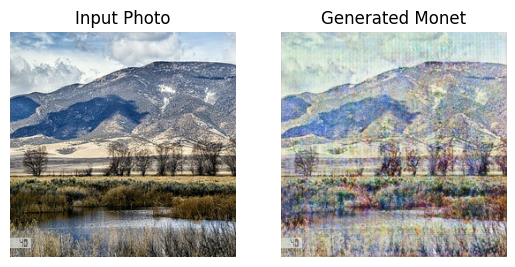

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 678ms/step - D_X_loss: 0.5755 - D_Y_loss: 0.3808 - F_loss: 3.6097 - G_loss: 4.5388
Epoch 14/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 677ms/step - D_X_loss: 0.5626 - D_Y_loss: 0.3280 - F_loss: 3.6929 - G_loss: 4.9208

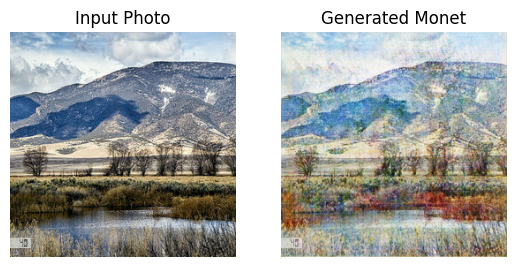

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 678ms/step - D_X_loss: 0.5626 - D_Y_loss: 0.3282 - F_loss: 3.6921 - G_loss: 4.9194
Epoch 15/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 679ms/step - D_X_loss: 0.5524 - D_Y_loss: 0.2926 - F_loss: 3.8442 - G_loss: 5.3135

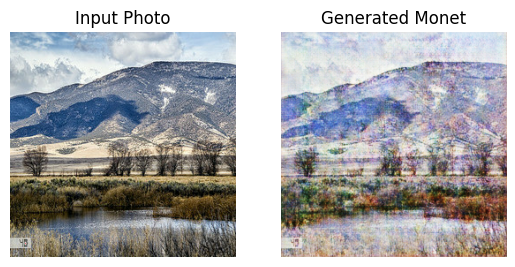

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 680ms/step - D_X_loss: 0.5525 - D_Y_loss: 0.2924 - F_loss: 3.8441 - G_loss: 5.3128
Epoch 16/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 681ms/step - D_X_loss: 0.5542 - D_Y_loss: 0.2659 - F_loss: 3.8151 - G_loss: 5.5787

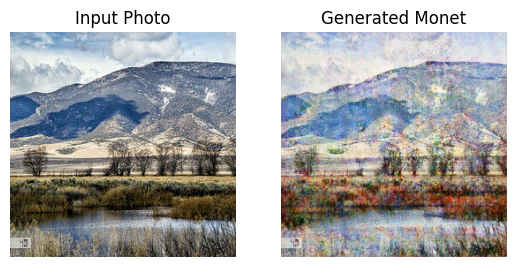

450/450 ━━━━━━━━━━━━━━━━━━━━ 307s 682ms/step - D_X_loss: 0.5541 - D_Y_loss: 0.2658 - F_loss: 3.8151 - G_loss: 5.5783
Epoch 17/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 681ms/step - D_X_loss: 0.5534 - D_Y_loss: 0.2398 - F_loss: 3.9039 - G_loss: 6.0131

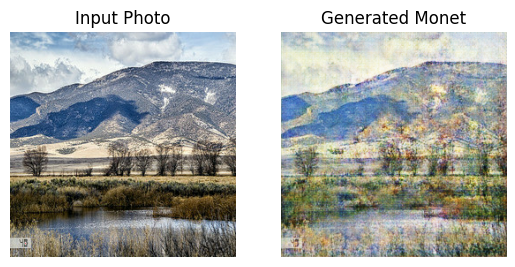

450/450 ━━━━━━━━━━━━━━━━━━━━ 307s 682ms/step - D_X_loss: 0.5535 - D_Y_loss: 0.2395 - F_loss: 3.9049 - G_loss: 6.0134
Epoch 18/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 680ms/step - D_X_loss: 0.5646 - D_Y_loss: 0.2116 - F_loss: 3.8719 - G_loss: 6.2123

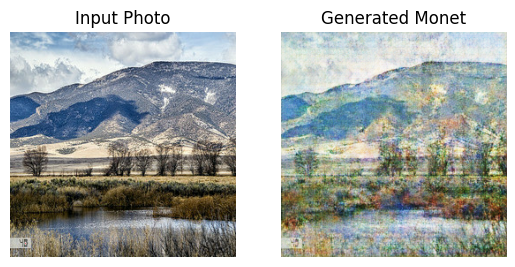

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 681ms/step - D_X_loss: 0.5641 - D_Y_loss: 0.2114 - F_loss: 3.8728 - G_loss: 6.2111
Epoch 19/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 680ms/step - D_X_loss: 0.5711 - D_Y_loss: 0.2045 - F_loss: 3.8406 - G_loss: 6.4686

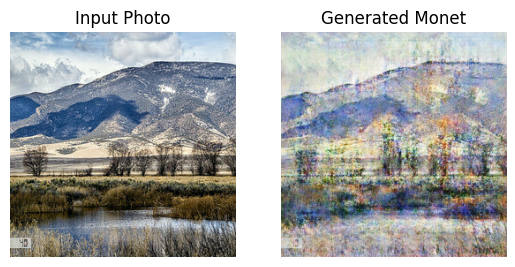

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 681ms/step - D_X_loss: 0.5711 - D_Y_loss: 0.2044 - F_loss: 3.8398 - G_loss: 6.4707
Epoch 20/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 677ms/step - D_X_loss: 0.5787 - D_Y_loss: 0.1834 - F_loss: 3.8317 - G_loss: 6.8924

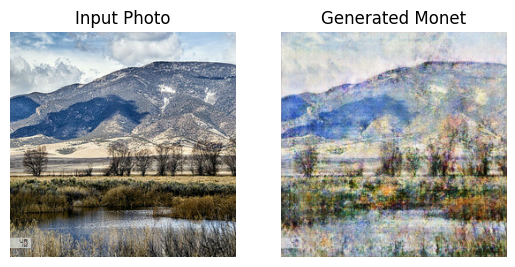

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 678ms/step - D_X_loss: 0.5791 - D_Y_loss: 0.1838 - F_loss: 3.8309 - G_loss: 6.8892
Epoch 21/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 680ms/step - D_X_loss: 0.5813 - D_Y_loss: 0.1547 - F_loss: 3.8367 - G_loss: 7.0166

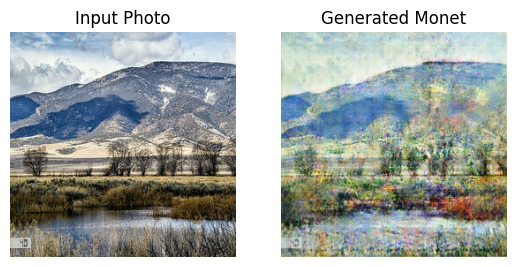

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 681ms/step - D_X_loss: 0.5817 - D_Y_loss: 0.1546 - F_loss: 3.8356 - G_loss: 7.0146
Epoch 22/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.5957 - D_Y_loss: 0.1736 - F_loss: 3.7279 - G_loss: 7.1509

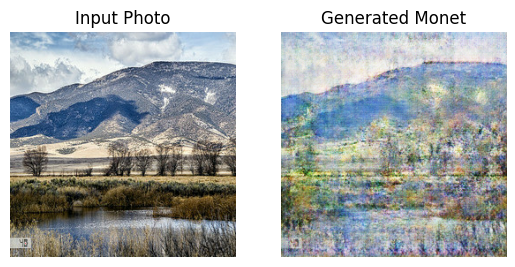

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 679ms/step - D_X_loss: 0.5958 - D_Y_loss: 0.1734 - F_loss: 3.7284 - G_loss: 7.1502
Epoch 23/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.5968 - D_Y_loss: 0.1475 - F_loss: 3.7445 - G_loss: 7.4670

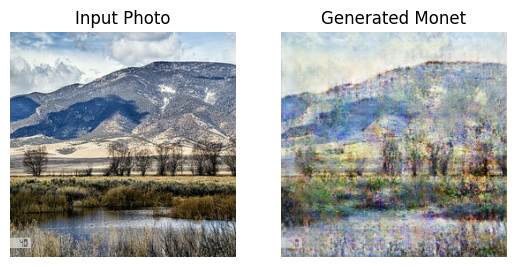

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 679ms/step - D_X_loss: 0.5965 - D_Y_loss: 0.1476 - F_loss: 3.7446 - G_loss: 7.4650
Epoch 24/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.5894 - D_Y_loss: 0.1311 - F_loss: 3.7255 - G_loss: 7.5996

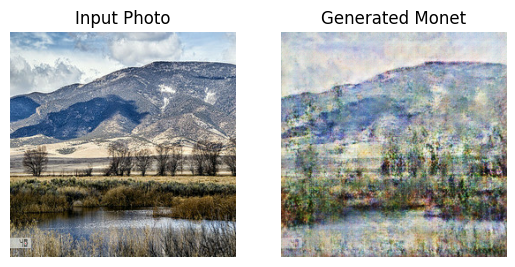

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 681ms/step - D_X_loss: 0.5895 - D_Y_loss: 0.1310 - F_loss: 3.7243 - G_loss: 7.5982
Epoch 25/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.6037 - D_Y_loss: 0.1496 - F_loss: 3.6637 - G_loss: 7.7908

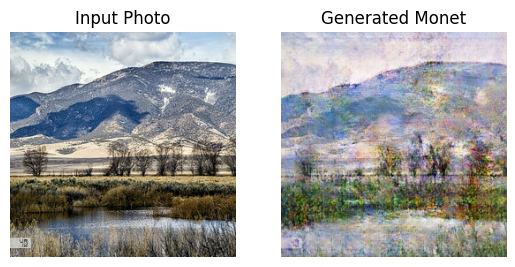

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 679ms/step - D_X_loss: 0.6038 - D_Y_loss: 0.1494 - F_loss: 3.6629 - G_loss: 7.7891
Epoch 26/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.6129 - D_Y_loss: 0.1276 - F_loss: 3.6382 - G_loss: 7.9153

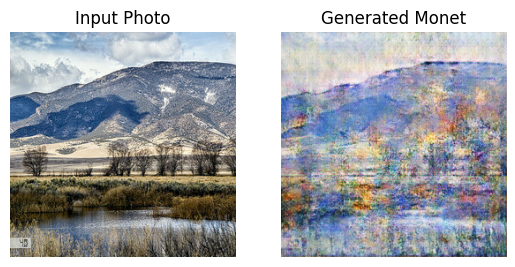

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 679ms/step - D_X_loss: 0.6131 - D_Y_loss: 0.1276 - F_loss: 3.6379 - G_loss: 7.9135
Epoch 27/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.5987 - D_Y_loss: 0.1007 - F_loss: 3.6857 - G_loss: 8.1390

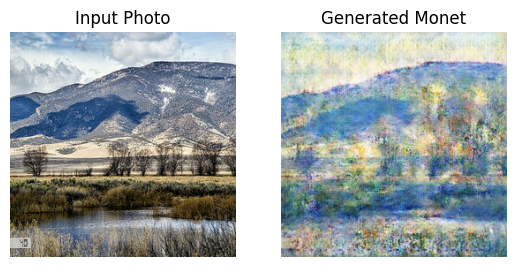

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 679ms/step - D_X_loss: 0.5985 - D_Y_loss: 0.1006 - F_loss: 3.6857 - G_loss: 8.1364
Epoch 28/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.6041 - D_Y_loss: 0.1102 - F_loss: 3.7052 - G_loss: 8.6771

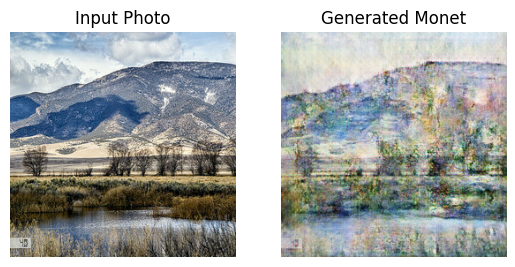

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 679ms/step - D_X_loss: 0.6041 - D_Y_loss: 0.1102 - F_loss: 3.7058 - G_loss: 8.6759
Epoch 29/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 679ms/step - D_X_loss: 0.6195 - D_Y_loss: 0.1110 - F_loss: 3.5921 - G_loss: 8.5425

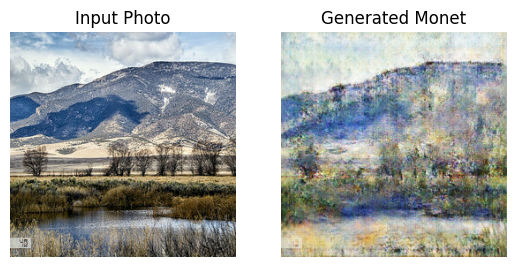

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 679ms/step - D_X_loss: 0.6196 - D_Y_loss: 0.1110 - F_loss: 3.5918 - G_loss: 8.5480
Epoch 30/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 679ms/step - D_X_loss: 0.5986 - D_Y_loss: 0.1144 - F_loss: 3.6602 - G_loss: 8.7264

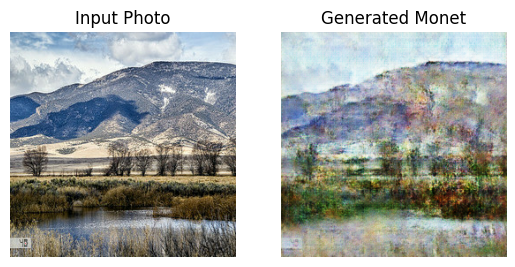

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 680ms/step - D_X_loss: 0.5985 - D_Y_loss: 0.1149 - F_loss: 3.6611 - G_loss: 8.7296
Epoch 31/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 679ms/step - D_X_loss: 0.6133 - D_Y_loss: 0.0978 - F_loss: 3.6446 - G_loss: 8.8821

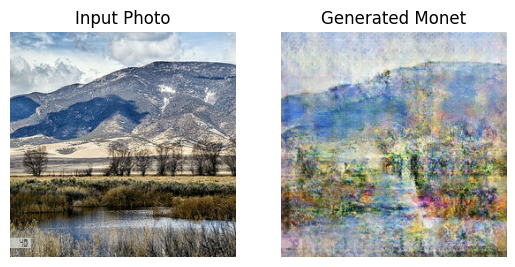

450/450 ━━━━━━━━━━━━━━━━━━━━ 306s 679ms/step - D_X_loss: 0.6132 - D_Y_loss: 0.0977 - F_loss: 3.6452 - G_loss: 8.8816
Epoch 32/32
450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 678ms/step - D_X_loss: 0.5952 - D_Y_loss: 0.1075 - F_loss: 3.7503 - G_loss: 9.2664

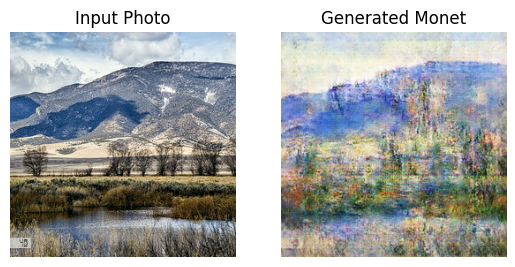

450/450 ━━━━━━━━━━━━━━━━━━━━ 305s 678ms/step - D_X_loss: 0.5954 - D_Y_loss: 0.1074 - F_loss: 3.7502 - G_loss: 9.2716


In [14]:
class DisplayCallback(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        for real_photo in photo_dataset.take(1):
            fake_monet = self.model.generator_G(real_photo, training=False)
            plt.subplot(1, 2, 1)
            plt.imshow((real_photo[0] * 0.5) + 0.5)
            plt.title("Input Photo")
            plt.axis("off")

            plt.subplot(1, 2, 2)
            plt.imshow((fake_monet[0] * 0.5) + 0.5)
            plt.title("Generated Monet")
            plt.axis("off")

            plt.show()

cycle_gan_model.fit(
    train_dataset,
    epochs=EPOCHS,
    steps_per_epoch=450,
    callbacks=[DisplayCallback()]
)

## Results Sample

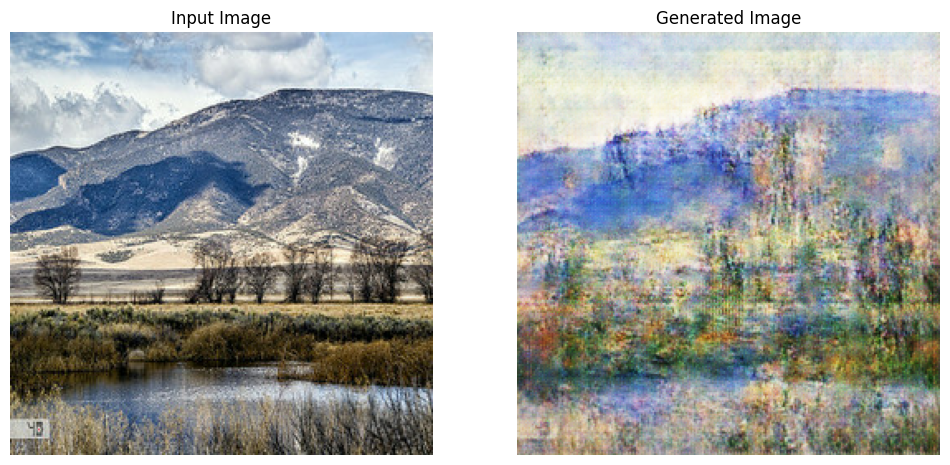

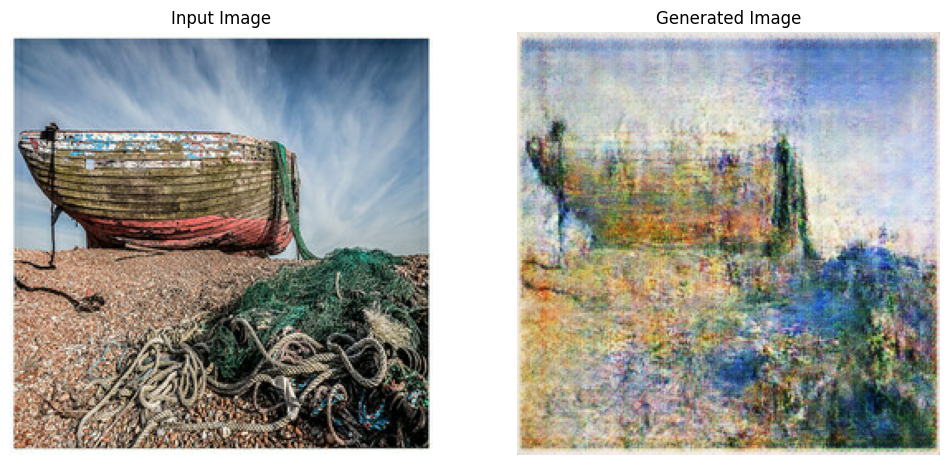

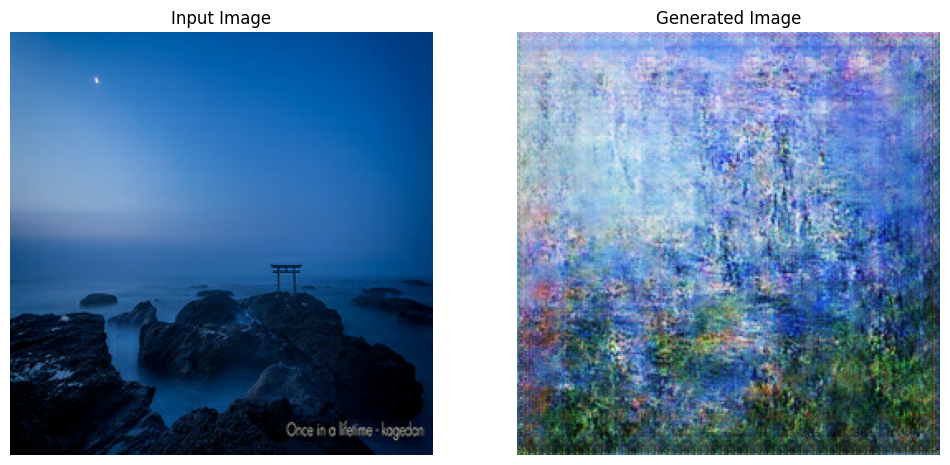

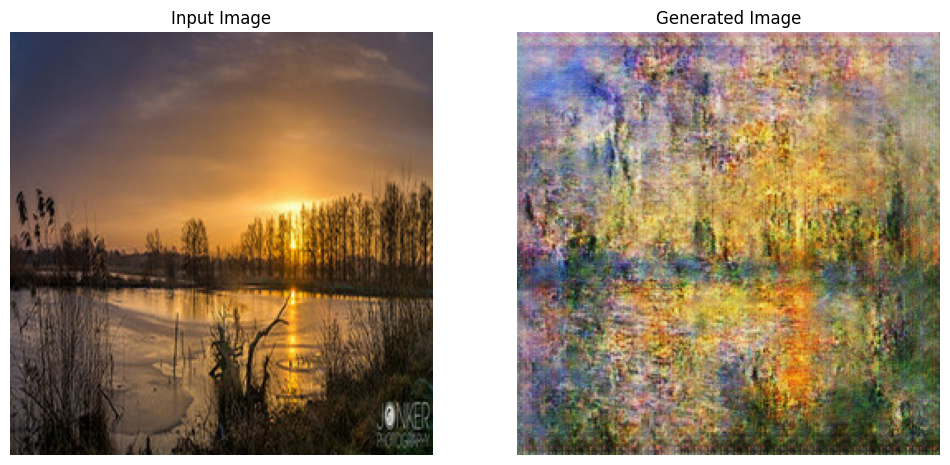

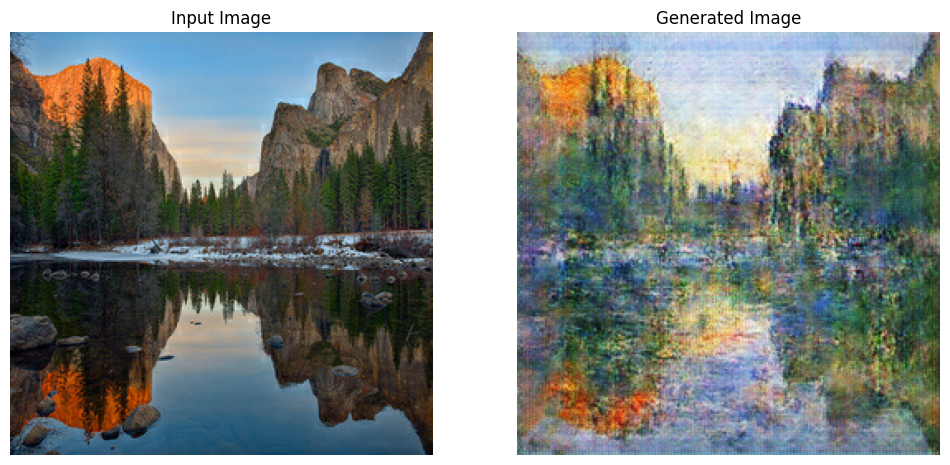

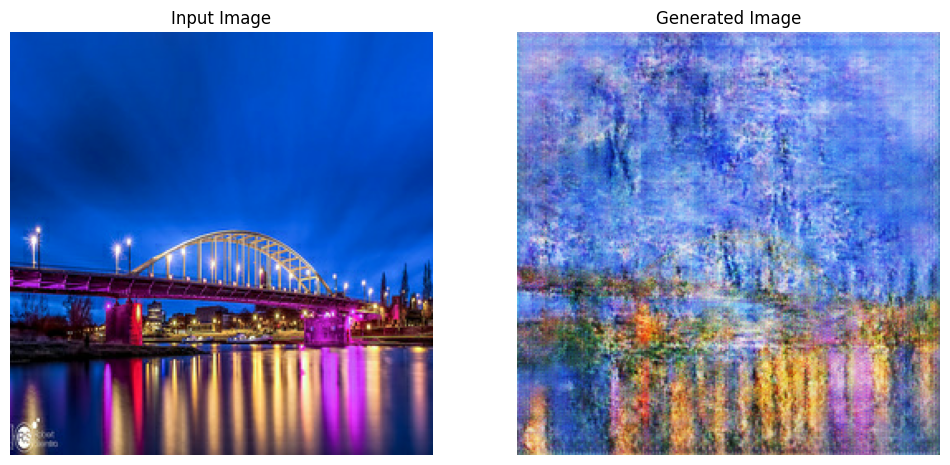

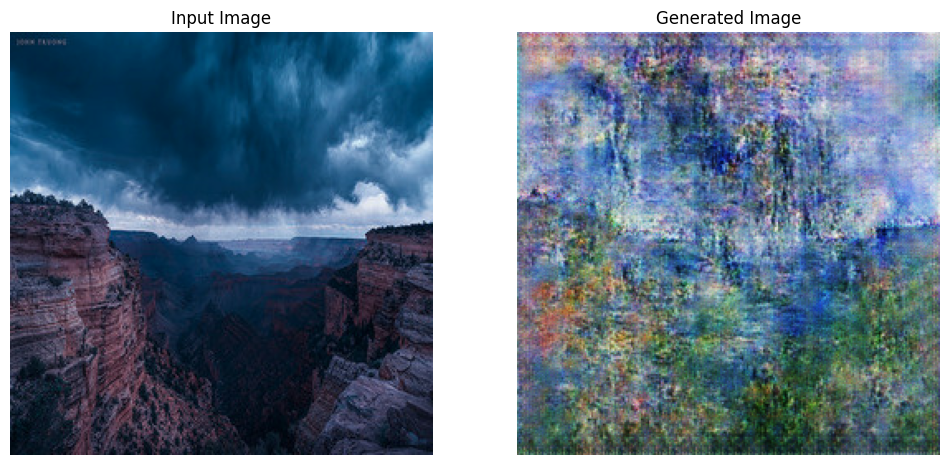

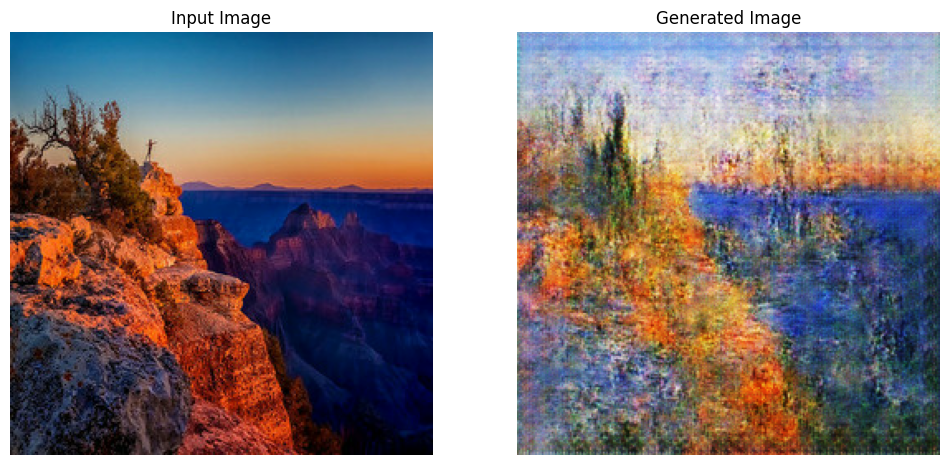

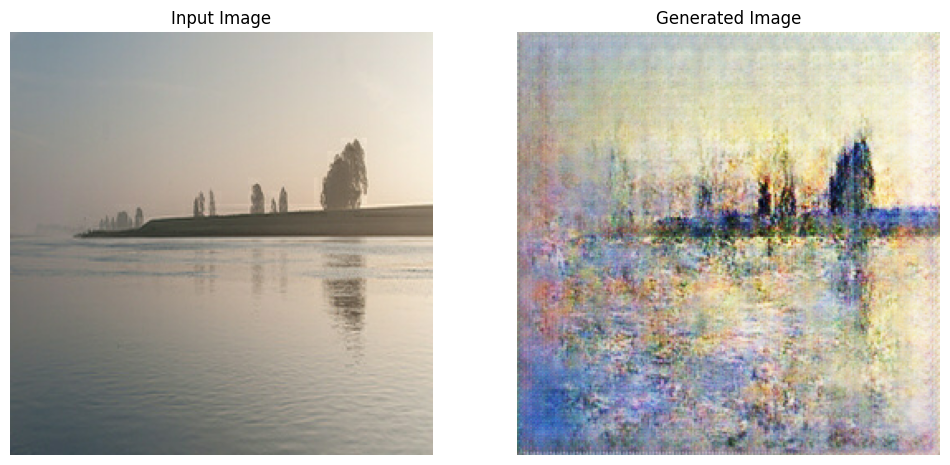

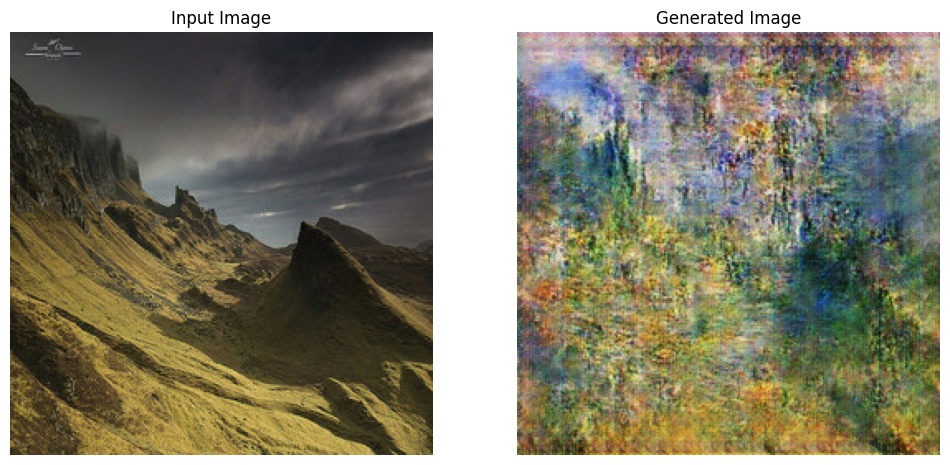

In [15]:
display_generated_samples(load_dataset(photo_files).batch(1), monet_generator, num_samples=10)

# Contest Submission

In [16]:
os.makedirs('../images', exist_ok=True)

i = 1

for img in tqdm(photo_dataset, total=7000):
    prediction = monet_generator(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    im = PIL.Image.fromarray(prediction)
    im.save(f"../images/{i}.jpg")
    i += 1
    if i > 7000:  # Limit to 7000 images
        break

100%|█████████▉| 6999/7000 [07:35<00:00, 15.35it/s]


In [17]:
import shutil

shutil.make_archive('images', 'zip', '../images')

'/kaggle/working/images.zip'

# Analysis and Conclusion